##**Биоинформатика: снижение рисков развития рецидива злокачественного новообразования**

In [12]:
# Импорт необходимых библиотек
import pandas as pd
from scipy.stats import ttest_ind
import statsmodels.api as sm
import numpy as np

In [7]:
# Загрузка данных
data = pd.read_csv('msk_impact_2017_clinical_data.csv')

In [8]:
# Очистка данных: удаление пропущенных значений в столбцах 'Mutation Count' и 'Overall Survival Status'
data_clean = data.dropna(subset=['Mutation Count', 'Overall Survival Status'])

# Преобразование статуса выживаемости в бинарные значения с использованием .loc
data_clean.loc[:, 'Survival_Status_Binary'] = data_clean['Overall Survival Status'].apply(lambda x: 1 if x == '0:LIVING' else 0)

# Разделение данных на группы: живые и умершие
alive_group = data_clean[data_clean['Survival_Status_Binary'] == 1]['Mutation Count']
deceased_group = data_clean[data_clean['Survival_Status_Binary'] == 0]['Mutation Count']


# Выполнение t-теста (независимый t-тест)
t_stat, p_value = ttest_ind(alive_group, deceased_group, equal_var=False)

# Вывод результатов
print("t-статистика:", t_stat)
print("p-значение:", p_value)

# Интерпретация
if p_value < 0.05:
    print("Разница в количестве мутаций между группами значима (p < 0.05).")
else:
    print("Разница в количестве мутаций между группами не является значимой (p >= 0.05).")

t-статистика: 1.4543233492617522
p-значение: 0.14589623716291028
Разница в количестве мутаций между группами не является значимой (p >= 0.05).


<ipython-input-8-aac17f5065a5>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_clean.loc[:, 'Survival_Status_Binary'] = data_clean['Overall Survival Status'].apply(lambda x: 1 if x == '0:LIVING' else 0)


In [13]:
# Проверка на пропущенные значения
print(data[['TMB (nonsynonymous)', 'Tumor Purity', 'Mutation Count']].isnull().sum())

# Замена NaN и inf значений
data[['TMB (nonsynonymous)', 'Tumor Purity', 'Mutation Count']] = data[['TMB (nonsynonymous)', 'Tumor Purity', 'Mutation Count']].replace([np.inf, -np.inf], np.nan)
data = data.dropna(subset=['TMB (nonsynonymous)', 'Tumor Purity', 'Mutation Count'])

# Подготовка данных для логистической регрессии
X = data[['TMB (nonsynonymous)', 'Tumor Purity', 'Mutation Count']]
X = sm.add_constant(X)
y = data['Survival_Status_Binary']

# Построение модели
logit_model = sm.Logit(y, X)
result = logit_model.fit()
print(result.summary())

TMB (nonsynonymous)      0
Tumor Purity           470
Mutation Count           0
dtype: int64
Optimization terminated successfully.
         Current function value: 0.588559
         Iterations 6
                             Logit Regression Results                             
Dep. Variable:     Survival_Status_Binary   No. Observations:                10475
Model:                              Logit   Df Residuals:                    10471
Method:                               MLE   Df Model:                            3
Date:                    Wed, 13 Nov 2024   Pseudo R-squ.:                0.008764
Time:                            06:08:29   Log-Likelihood:                -6165.2
converged:                           True   LL-Null:                       -6219.7
Covariance Type:                nonrobust   LLR p-value:                 1.783e-23
                          coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------

In [14]:
# Для отображения таблицы в Colab
from IPython.display import display
display(data_clean)

,Study ID,Patient ID,Sample ID,Cancer Type,Cancer Type Detailed,DNA Input,Fraction Genome Altered,Matched Status,Metastatic Site,Mutation Count,...,Sample Type,Sex,Smoking History,Somatic Status,Specimen Preservation Type,Specimen Type,TMB (nonsynonymous),Tumor Purity,Patient's Vital Status,Survival_Status_Binary
0,msk_impact_2017,P-0000004,P-0000004-T01-IM3,Breast Cancer,Breast Invasive Ductal Carcinoma,250.0,0.2782,Matched,NaN,16,...,Primary,Female,Unknown,Matched,FFPE,Biopsy,17.746485,50.0,ALIVE,1
1,msk_impact_2017,P-0000015,P-0000015-T01-IM3,Breast Cancer,Breast Invasive Ductal Carcinoma,198.0,0.3503,Matched,Liver,7,...,Metastasis,Female,Never,Matched,FFPE,Biopsy,7.764087,40.0,DECEASED,0
2,msk_impact_2017,P-0000023,P-0000023-T01-IM3,Mesothelioma,Peritoneal Mesothelioma,250.0,0.1596,Matched,NaN,5,...,Primary,Male,Never,Matched,FFPE,Biopsy,5.545777,30.0,DECEASED,0
3,msk_impact_2017,P-0000024,P-0000024-T01-IM3,Endometrial Cancer,Uterine Endometrioid Carcinoma,250.0,0.3878,Matched,Lung,6,...,Metastasis,Female,Prev/Curr Smoker,Matched,FFPE,Resection,6.654932,40.0,ALIVE,1
4,msk_impact_2017,P-0000025,P-0000025-T01-IM3,Endometrial Cancer,Uterine Serous Carcinoma/Uterine Papillary Ser...,250.0,0.0000,Matched,NaN,1,...,Primary,Female,Never,Matched,FFPE,Resection,1.109155,NaN,ALIVE,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10940,msk_impact_2017,P-0012442,P-0012442-T01-IM5,Pancreatic Cancer,Pancreatic Adenocarcinoma,250.0,0.0693,Matched,NaN,2,...,Primary,Female,Unknown,Matched,FFPE,Resection,1.957439,30.0,ALIVE,1
10941,msk_impact_2017,P-0012500,P-0012500-T01-IM5,Breast Cancer,Invasive Breast Carcinoma,250.0,0.0635,Matched,NaN,2,...,Primary,Female,Prev/Curr Smoker,Matched,FFPE,Resection,1.957439,50.0,ALIVE,1
10942,msk_impact_2017,P-0012524,P-0012524-T01-IM5,Mature B-Cell Neoplasms,"Diffuse Large B-Cell Lymphoma, NOS",250.0,0.1143,Unmatched,NaN,11,...,Primary,Male,Never,Unmatched,FFPE,Biopsy,10.765917,70.0,DECEASED,0
10943,msk_impact_2017,P-0012557,P-0012557-T01-IM5,Bladder Cancer,Bladder Urothelial Carcinoma,90.0,0.2776,Matched,Soft Tissue,15,...,Metastasis,Female,Prev/Curr Smoker,Matched,FFPE,Biopsy,14.680795,40.0,ALIVE,1


In [17]:
# Отображаем весь датасет
pd.set_option('display.max_rows', None)  # Разрешаем выводить все строки
pd.set_option('display.max_columns', None)  # Разрешаем выводить все столбцы

display(data_clean)  # Выводим датасет

,Study ID,Patient ID,Sample ID,Cancer Type,Cancer Type Detailed,DNA Input,Fraction Genome Altered,Matched Status,Metastatic Site,Mutation Count,Oncotree Code,Overall Survival (Months),Overall Survival Status,Primary Tumor Site,Sample Class,Sample Collection Source,Number of Samples Per Patient,Sample coverage,Sample Type,Sex,Smoking History,Somatic Status,Specimen Preservation Type,Specimen Type,TMB (nonsynonymous),Tumor Purity,Patient's Vital Status,Survival_Status_Binary
0,msk_impact_2017,P-0000004,P-0000004-T01-IM3,Breast Cancer,Breast Invasive Ductal Carcinoma,250.000,0.2782,Matched,NaN,16,IDC,NaN,0:LIVING,Breast,Tumor,Outside,1,428,Primary,Female,Unknown,Matched,FFPE,Biopsy,17.746485,50.0,ALIVE,1
1,msk_impact_2017,P-0000015,P-0000015-T01-IM3,Breast Cancer,Breast Invasive Ductal Carcinoma,198.000,0.3503,Matched,Liver,7,IDC,NaN,1:DECEASED,Breast,Tumor,In-House,1,281,Metastasis,Female,Never,Matched,FFPE,Biopsy,7.764087,40.0,DECEASED,0
2,msk_impact_2017,P-0000023,P-0000023-T01-IM3,Mesothelioma,Peritoneal Mesothelioma,250.000,0.1596,Matched,NaN,5,PEMESO,8.71,1:DECEASED,Peritoneum,Tumor,In-House,1,454,Primary,Male,Never,Matched,FFPE,Biopsy,5.545777,30.0,DECEASED,0
3,msk_impact_2017,P-0000024,P-0000024-T01-IM3,Endometrial Cancer,Uterine Endometrioid Carcinoma,250.000,0.3878,Matched,Lung,6,UEC,36.75,0:LIVING,Uterus,Tumor,In-House,1,1016,Metastasis,Female,Prev/Curr Smoker,Matched,FFPE,Resection,6.654932,40.0,ALIVE,1
4,msk_impact_2017,P-0000025,P-0000025-T01-IM3,Endometrial Cancer,Uterine Serous Carcinoma/Uterine Papillary Ser...,250.000,0.0000,Matched,NaN,1,USC,8.81,0:LIVING,Uterus,Tumor,In-House,2,1161,Primary,Female,Never,Matched,FFPE,Resection,1.109155,NaN,ALIVE,1
5,msk_impact_2017,P-0000025,P-0000025-T02-IM5,Endometrial Cancer,Uterine Serous Carcinoma/Uterine Papillary Ser...,250.000,0.1020,Matched,Peritoneum,2,USC,8.81,0:LIVING,Uterus,Tumor,In-House,2,1147,Metastasis,Female,Never,Matched,FFPE,Biopsy,1.957439,30.0,ALIVE,1
6,msk_impact_2017,P-0000026,P-0000026-T01-IM3,Endometrial Cancer,Uterine Endometrioid Carcinoma,250.000,0.4196,Matched,Pelvis,4,UEC,NaN,0:LIVING,Uterus,Tumor,In-House,1,1222,Metastasis,Female,Never,Matched,FFPE,Cytology,4.436621,10.0,ALIVE,1
7,msk_impact_2017,P-0000027,P-0000027-T01-IM3,Mesothelioma,"Pleural Mesothelioma, Epithelioid Type",250.000,0.0295,Matched,NaN,1,PLEMESO,NaN,1:DECEASED,Lung,Tumor,Outside,1,668,Primary,Female,Never,Matched,FFPE,Biopsy,0.000000,NaN,DECEASED,0
8,msk_impact_2017,P-0000030,P-0000030-T01-IM3,Non-Small Cell Lung Cancer,Lung Adenocarcinoma,250.000,0.4730,Unmatched,Lymph Node,10,LUAD,NaN,0:LIVING,Lung,Tumor,Outside,1,757,Metastasis,Female,Unknown,Unmatched,FFPE,Biopsy,11.091553,40.0,ALIVE,1
9,msk_impact_2017,P-0000034,P-0000034-T01-IM3,Bladder Cancer,Bladder Urothelial Carcinoma,250.000,0.1591,Matched,NaN,12,BLCA,NaN,1:DECEASED,Bladder,Tumor,In-House,1,461,Primary,Male,Prev/Curr Smoker,Matched,FFPE,Resection,13.309864,40.0,DECEASED,0


In [18]:
# Проверка на пропущенные значения
print(data_clean.isnull().sum())


Study ID                            0
Patient ID                          0
Sample ID                           0
Cancer Type                         0
Cancer Type Detailed                0
DNA Input                           0
Fraction Genome Altered             6
Matched Status                      0
Metastatic Site                  6165
Mutation Count                      0
Oncotree Code                       0
Overall Survival (Months)        2801
Overall Survival Status             0
Primary Tumor Site                 28
Sample Class                        0
Sample Collection Source            0
Number of Samples Per Patient       0
Sample coverage                     0
Sample Type                         0
Sex                                 0
Smoking History                     0
Somatic Status                      0
Specimen Preservation Type          0
Specimen Type                       1
TMB (nonsynonymous)                 0
Tumor Purity                      470
Patient's Vi

In [19]:
# Проверка типов данных
print(data_clean.dtypes)


Study ID                          object
Patient ID                        object
Sample ID                         object
Cancer Type                       object
Cancer Type Detailed              object
DNA Input                        float64
Fraction Genome Altered          float64
Matched Status                    object
Metastatic Site                   object
Mutation Count                     int64
Oncotree Code                     object
Overall Survival (Months)        float64
Overall Survival Status           object
Primary Tumor Site                object
Sample Class                      object
Sample Collection Source          object
Number of Samples Per Patient      int64
Sample coverage                    int64
Sample Type                       object
Sex                               object
Smoking History                   object
Somatic Status                    object
Specimen Preservation Type        object
Specimen Type                     object
TMB (nonsynonymo

In [20]:
# Проверка уникальных значений в категориальных признаках
print(data_clean['Cancer Type'].unique())
print(data_clean['Sex'].unique())
print(data_clean['Overall Survival Status'].unique())


['Breast Cancer' 'Mesothelioma' 'Endometrial Cancer'
 'Non-Small Cell Lung Cancer' 'Bladder Cancer' 'Hepatobiliary Cancer'
 'Esophagogastric Cancer' 'Ovarian Cancer' 'Uterine Sarcoma'
 'Germ Cell Tumor' 'Small Cell Lung Cancer' 'Sex Cord Stromal Tumor'
 'Colorectal Cancer' 'Gastrointestinal Stromal Tumor' 'Cervical Cancer'
 'Prostate Cancer' 'Pancreatic Cancer' 'Soft Tissue Sarcoma'
 'Thyroid Cancer' 'Salivary Gland Cancer' 'Anal Cancer' 'Glioma'
 'Head and Neck Cancer' 'Bone Cancer' 'Skin Cancer, Non-Melanoma'
 'Renal Cell Carcinoma' 'Cancer of Unknown Primary' 'CNS Cancer'
 'Melanoma' 'Nerve Sheath Tumor' 'Thymic Tumor' 'Adrenocortical Carcinoma'
 'Histiocytosis' 'Appendiceal Cancer' 'Small Bowel Cancer'
 'Gastrointestinal Neuroendocrine Tumor' 'Penile Cancer' 'Vaginal Cancer'
 'Peripheral Nervous System' 'Wilms Tumor' 'Ampullary Cancer'
 'Pheochromocytoma' 'Pineal Tumor' 'Miscellaneous Brain Tumor'
 'Ampullary Carcinoma' 'Miscellaneous Neuroepithelial Tumor'
 'Mastocytosis' 'Mature 

In [21]:
# Описание статистических данных
print(data_clean.describe())


          DNA Input  Fraction Genome Altered  Mutation Count  \
count  10943.000000             10937.000000    10943.000000   
mean     238.596014                 0.194650        7.136983   
std       36.338804                 0.189342       16.860496   
min       50.000000                 0.000000        0.000000   
25%      250.000000                 0.035500        2.000000   
50%      250.000000                 0.144800        4.000000   
75%      250.000000                 0.296200        7.000000   
max      250.000000                 1.000000      456.000000   

       Overall Survival (Months)  Number of Samples Per Patient  \
count                8142.000000                   10943.000000   
mean                   12.456394                       1.120625   
std                     7.765755                       0.371333   
min                     0.000000                       1.000000   
25%                     6.540000                       1.000000   
50%                  

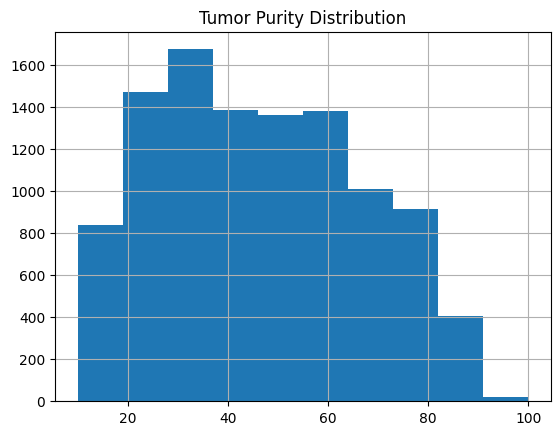

In [22]:
# Проверка распределения данных
import matplotlib.pyplot as plt
data_clean['Tumor Purity'].hist()
plt.title('Tumor Purity Distribution')
plt.show()


In [23]:
# Проверка на выбросы
from scipy import stats
print(stats.zscore(data_clean[['Mutation Count', 'TMB (nonsynonymous)', 'Tumor Purity']]))


       Mutation Count  TMB (nonsynonymous)  Tumor Purity
0            0.525692             0.641132           NaN
1           -0.008125             0.043128           NaN
2           -0.126751            -0.089762           NaN
3           -0.067438            -0.023317           NaN
4           -0.364003            -0.355541           NaN
5           -0.304690            -0.304724           NaN
6           -0.186064            -0.156207           NaN
7           -0.364003            -0.421986           NaN
8            0.169814             0.242463           NaN
9            0.288440             0.375353           NaN
10          -0.245377            -0.222651           NaN
11          -0.186064            -0.156207           NaN
12          -0.245377            -0.222651           NaN
13          -0.304690            -0.289096           NaN
14          -0.245377            -0.222651           NaN
15          -0.364003            -0.355541           NaN
16           1.178134          

In [24]:
# Корреляционный анализ
correlation_matrix = data_clean[['Mutation Count', 'TMB (nonsynonymous)', 'Tumor Purity']].corr()
print(correlation_matrix)


                     Mutation Count  TMB (nonsynonymous)  Tumor Purity
Mutation Count             1.000000             0.998434      0.012702
TMB (nonsynonymous)        0.998434             1.000000      0.010456
Tumor Purity               0.012702             0.010456      1.000000


1. Корреляция между Mutation Count и TMB (nonsynonymous)

- Значение корреляции: 0.998434.

    Это означает, что между этими двумя переменными существует очень сильная положительная линейная связь. В большинстве случаев, увеличение Mutation Count будет сопровождаться увеличением TMB (nonsynonymous) (общее количество мутаций и мутации, не изменяющие кодон). Это подтверждает, что оба эти показателя скорее всего связаны с общей мутационной нагрузкой в опухоли.

2. Корреляция между Mutation Count и Tumor Purity
- Значение корреляции: 0.012702.

    Это значение близко к нулю, что указывает на практически отсутствие линейной связи между количеством мутаций и чистотой опухоли. Это может означать, что увеличение количества мутаций не обязательно связано с чистотой опухоли (процентное содержание опухолевых клеток в образце).

3. Корреляция между TMB (nonsynonymous) и Tumor Purity
- Значение корреляции: 0.010456.

    Это значение также близко к нулю, что говорит о слабой линейной связи между этими переменными. Это также подтверждает, что чистота опухоли не имеет значимого влияния на количество некодирующих мутаций в образце.

Выводы:
* Высокая корреляция между Mutation Count и TMB (nonsynonymous) говорит о том, что эти два признака можно рассматривать как взаимозаменяемые для модели, поскольку они тесно связаны.

* Низкая корреляция с Tumor Purity указывает на то, что чистота опухоли имеет мало общего с количеством мутаций в опухолевых клетках или мутационной нагрузкой, что может быть полезно при построении моделей, где важны только мутационные характеристики, а не состав клеток.

In [26]:
# Перепроверка категориальных данных
print(data_clean['Sample Type'].value_counts())
print(data_clean['Specimen Type'].value_counts())



Sample Type
Primary       6212
Metastasis    4731
Name: count, dtype: int64
Specimen Type
Resection    5441
Biopsy       4915
Cytology      585
CUSA            1
Name: count, dtype: int64


In [27]:
# Проверка на дисбаланс классов (выживаемость)
print(data_clean['Survival_Status_Binary'].value_counts())


Survival_Status_Binary
1    7830
0    3113
Name: count, dtype: int64
